In [1]:
import tensorflow_datasets as tfds 
tfds.load("div2k/bicubic_x4")

EXTRACTING {'train_lr_url': 'https://data.vision.ee.ethz.ch/cvl/DIV2K/DIV2K_train_LR_bicubic_X4.zip', 'valid_lr_url': 'https://data.vision.ee.ethz.ch/cvl/DIV2K/DIV2K_valid_LR_bicubic_X4.zip', 'train_hr_url': 'https://data.vision.ee.ethz.ch/cvl/DIV2K/DIV2K_train_HR.zip', 'valid_hr_url': 'https://data.vision.ee.ethz.ch/cvl/DIV2K/DIV2K_valid_HR.zip'}


Dl Completed...: 0 url [00:00, ? url/s]

Dl Size...: 0 MiB [00:00, ? MiB/s]

Extraction completed...: 0 file [00:00, ? file/s]

Generating splits...:   0%|          | 0/2 [00:00<?, ? splits/s]

Generating train examples...:   0%|          | 0/800 [00:00<?, ? examples/s]

Shuffling div2k-train.tfrecord...:   0%|          | 0/800 [00:00<?, ? examples/s]

Generating validation examples...:   0%|          | 0/100 [00:00<?, ? examples/s]

Shuffling div2k-validation.tfrecord...:   0%|          | 0/100 [00:00<?, ? examples/s]

Dataset div2k downloaded and prepared to /aiffel/tensorflow_datasets/div2k/bicubic_x4/2.0.0. Subsequent calls will reuse this data.


{Split('train'): <PrefetchDataset shapes: {hr: (None, None, 3), lr: (None, None, 3)}, types: {hr: tf.uint8, lr: tf.uint8}>,
 Split('validation'): <PrefetchDataset shapes: {hr: (None, None, 3), lr: (None, None, 3)}, types: {hr: tf.uint8, lr: tf.uint8}>}

In [2]:
import os
import cv2
import imageio
import numpy as np
import tensorflow as tf
from skimage import data
import matplotlib.pyplot as plt
from tensorflow.python.keras import applications
from tensorflow.keras import losses, metrics, optimizers
from tensorflow.keras import Input, Model, layers
from skimage.metrics import peak_signal_noise_ratio, structural_similarity
from IPython.display import Image as show_gif

프로젝트 1-1

(1200, 1920, 3)


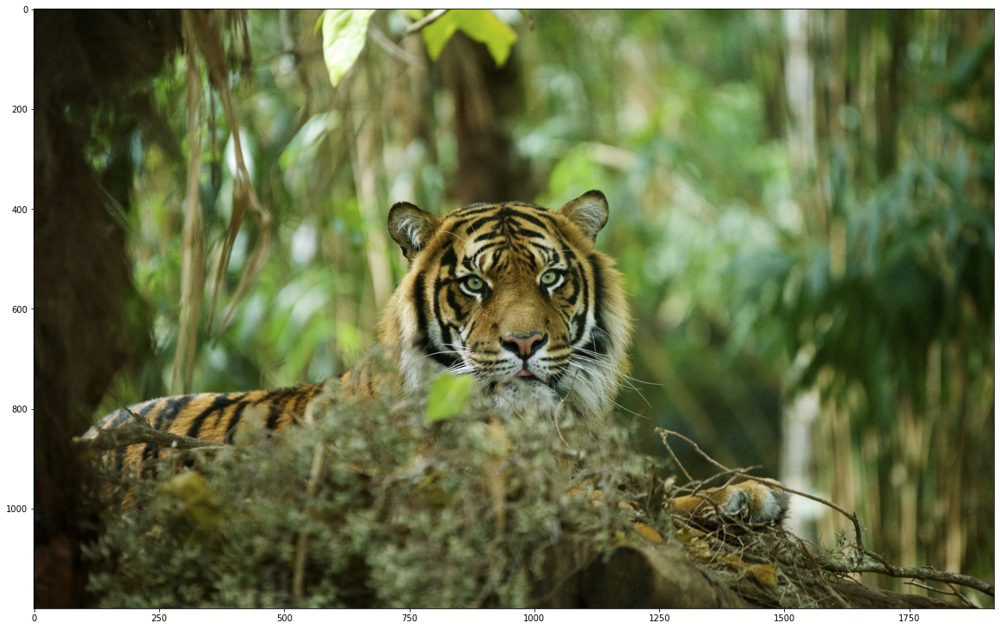

In [3]:
PATH = os.path.join(os.getenv('HOME')+'/aiffel/super_resolution/1920img.jpg')

hr_image = plt.imread(PATH)
print(hr_image.shape)
plt.figure(figsize=(20,20))
plt.imshow(hr_image)

(300, 480, 3)


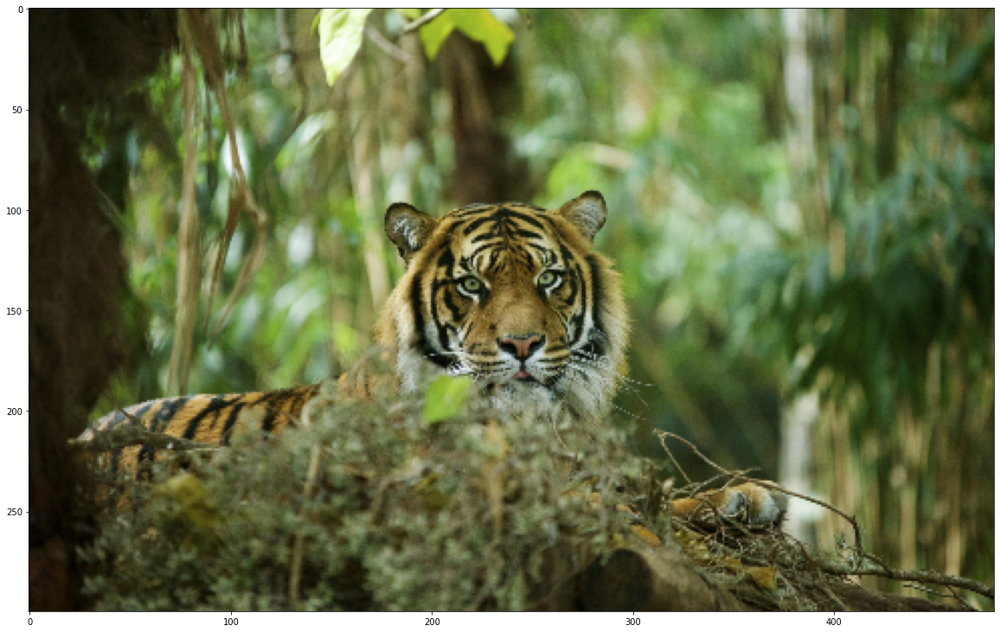

In [4]:
lr_image = cv2.resize(hr_image, dsize=(hr_image.shape[1]//4,hr_image.shape[0]//4)) # (가로 픽셀 수, 세로 픽셀 수)

print(lr_image.shape)

plt.figure(figsize=(20,20))
plt.imshow(lr_image)

In [5]:
train, valid = tfds.load(
    "div2k/bicubic_x4", 
    split=["train","validation"],
    as_supervised=True
)
def preprocessing(lr, hr):
    hr = tf.cast(hr, tf.float32) /255.
        
    # 이미지의 크기가 크므로 (96,96,3) 크기로 임의 영역을 잘라내어 사용합니다.
    hr_patch = tf.image.random_crop(hr, size=[96,96,3])
        
    # 잘라낸 고해상도 이미지의 가로, 세로 픽셀 수를 1/4배로 줄입니다
    # 이렇게 만든 저해상도 이미지를 SRGAN의 입력으로 사용합니다.
    lr_patch = tf.image.resize(hr_patch, [96//4, 96//4], "bicubic")
    return lr_patch, hr_patch

train = train.map(preprocessing).shuffle(buffer_size=10).repeat().batch(8)
valid = valid.map(preprocessing).repeat().batch(8)

In [6]:
# 그림의 파란색 블록을 정의합니다.
def gene_base_block(x):
    out = layers.Conv2D(64, 3, 1, "same")(x)
    out = layers.BatchNormalization()(out)
    out = layers.PReLU(shared_axes=[1,2])(out)
    out = layers.Conv2D(64, 3, 1, "same")(out)
    out = layers.BatchNormalization()(out)
    return layers.Add()([x, out])

# 그림의 뒤쪽 연두색 블록을 정의합니다.
def upsample_block(x):
    out = layers.Conv2D(256, 3, 1, "same")(x)
    # 그림의 PixelShuffler 라고 쓰여진 부분을 아래와 같이 구현합니다.
    out = layers.Lambda(lambda x: tf.nn.depth_to_space(x, 2))(out)
    return layers.PReLU(shared_axes=[1,2])(out)
    
# 전체 Generator를 정의합니다.
def get_generator(input_shape=(None, None, 3)):
    inputs = Input(input_shape)
    
    out = layers.Conv2D(64, 9, 1, "same")(inputs)
    out = residual = layers.PReLU(shared_axes=[1,2])(out)
    
    for _ in range(5):
        out = gene_base_block(out)
    
    out = layers.Conv2D(64, 3, 1, "same")(out)
    out = layers.BatchNormalization()(out)
    out = layers.Add()([residual, out])
    
    for _ in range(2):
        out = upsample_block(out)
        
    out = layers.Conv2D(3, 9, 1, "same", activation="tanh")(out)
    return Model(inputs, out)

In [7]:
# 그림의 파란색 블록을 정의합니다.
def disc_base_block(x, n_filters=128):
    out = layers.Conv2D(n_filters, 3, 1, "same")(x)
    out = layers.BatchNormalization()(out)
    out = layers.LeakyReLU()(out)
    out = layers.Conv2D(n_filters, 3, 2, "same")(out)
    out = layers.BatchNormalization()(out)
    return layers.LeakyReLU()(out)

# 전체 Discriminator 정의합니다.
def get_discriminator(input_shape=(None, None, 3)):
    inputs = Input(input_shape)
    
    out = layers.Conv2D(64, 3, 1, "same")(inputs)
    out = layers.LeakyReLU()(out)
    out = layers.Conv2D(64, 3, 2, "same")(out)
    out = layers.BatchNormalization()(out)
    out = layers.LeakyReLU()(out)
    
    for n_filters in [128, 256, 512]:
        out = disc_base_block(out, n_filters)
    
    out = layers.Dense(1024)(out)
    out = layers.LeakyReLU()(out)
    out = layers.Dense(1, activation="sigmoid")(out)
    return Model(inputs, out)

In [8]:
def get_feature_extractor(input_shape=(None, None, 3)):
    vgg = applications.vgg19.VGG19(
        include_top=False, 
        weights="imagenet", 
        input_shape=input_shape
    )
    # 아래 vgg.layers[20]은 vgg 내의 마지막 convolutional layer 입니다.
    return Model(vgg.input, vgg.layers[20].output)

In [9]:
generator = get_generator()
discriminator = get_discriminator()
vgg = get_feature_extractor()

# 사용할 loss function 및 optimizer 를 정의합니다.
bce = losses.BinaryCrossentropy(from_logits=False)
mse = losses.MeanSquaredError()
gene_opt = optimizers.Adam()
disc_opt = optimizers.Adam()

def get_gene_loss(fake_out):
    return bce(tf.ones_like(fake_out), fake_out)

def get_disc_loss(real_out, fake_out):
    return bce(tf.ones_like(real_out), real_out) + bce(tf.zeros_like(fake_out), fake_out)


@tf.function
def get_content_loss(hr_real, hr_fake):
    hr_real = applications.vgg19.preprocess_input(hr_real)
    hr_fake = applications.vgg19.preprocess_input(hr_fake)
    
    hr_real_feature = vgg(hr_real) / 12.75
    hr_fake_feature = vgg(hr_fake) / 12.75
    return mse(hr_real_feature, hr_fake_feature)


@tf.function
def step(lr, hr_real):
    with tf.GradientTape() as gene_tape, tf.GradientTape() as disc_tape:
        hr_fake = generator(lr, training=True)
        
        real_out = discriminator(hr_real, training=True)
        fake_out = discriminator(hr_fake, training=True)
        
        perceptual_loss = get_content_loss(hr_real, hr_fake) + 1e-3 * get_gene_loss(fake_out)
        discriminator_loss = get_disc_loss(real_out, fake_out)
        
    gene_gradient = gene_tape.gradient(perceptual_loss, generator.trainable_variables)
    disc_gradient = disc_tape.gradient(discriminator_loss, discriminator.trainable_variables)
    
    gene_opt.apply_gradients(zip(gene_gradient, generator.trainable_variables))
    disc_opt.apply_gradients(zip(disc_gradient, discriminator.trainable_variables))
    return perceptual_loss, discriminator_loss


gene_losses = metrics.Mean()
disc_losses = metrics.Mean()

for epoch in range(1, 2):
    for i, (lr, hr) in enumerate(train):
        g_loss, d_loss = step(lr, hr)
        
        gene_losses.update_state(g_loss)
        disc_losses.update_state(d_loss)
        
        # 10회 반복마다 loss를 출력합니다.
        if (i+1) % 10 == 0:
            print(f"EPOCH[{epoch}] - STEP[{i+1}] \nGenerator_loss:{gene_losses.result():.4f} \nDiscriminator_loss:{disc_losses.result():.4f}", end="\n\n")
        
        if (i+1) == 200:
            break
            
    gene_losses.reset_states()
    disc_losses.reset_states()

80142336/80134624 [==============================] - 1s 0us/step
EPOCH[1] - STEP[10] 
Generator_loss:0.0011 
Discriminator_loss:1.7163

EPOCH[1] - STEP[20] 
Generator_loss:0.0012 
Discriminator_loss:1.2904

EPOCH[1] - STEP[30] 
Generator_loss:0.0018 
Discriminator_loss:0.9213

EPOCH[1] - STEP[40] 
Generator_loss:0.0023 
Discriminator_loss:0.7160

EPOCH[1] - STEP[50] 
Generator_loss:0.0028 
Discriminator_loss:0.6186

EPOCH[1] - STEP[60] 
Generator_loss:0.0031 
Discriminator_loss:0.5206

EPOCH[1] - STEP[70] 
Generator_loss:0.0035 
Discriminator_loss:0.4475

EPOCH[1] - STEP[80] 
Generator_loss:0.0039 
Discriminator_loss:0.3921

EPOCH[1] - STEP[90] 
Generator_loss:0.0042 
Discriminator_loss:0.3489

EPOCH[1] - STEP[100] 
Generator_loss:0.0046 
Discriminator_loss:0.3143

EPOCH[1] - STEP[110] 
Generator_loss:0.0048 
Discriminator_loss:0.2859

EPOCH[1] - STEP[120] 
Generator_loss:0.0050 
Discriminator_loss:0.2623

EPOCH[1] - STEP[130] 
Generator_loss:0.0052 
Discriminator_loss:0.2422

EPOCH[1]

In [10]:
model_file = os.getenv('HOME')+'/aiffel/super_resolution/srgan_G.h5'
srgan = tf.keras.models.load_model(model_file)

In [11]:
def apply_srgan(image):
    image = tf.cast(image[np.newaxis, ...], tf.float32)
    sr = srgan.predict(image)
    sr = tf.clip_by_value(sr, 0, 255)
    sr = tf.round(sr)
    sr = tf.cast(sr, tf.uint8)
    return np.array(sr)[0]

train, valid = tfds.load(
    "div2k/bicubic_x4", 
    split=["train","validation"],
    as_supervised=True
)

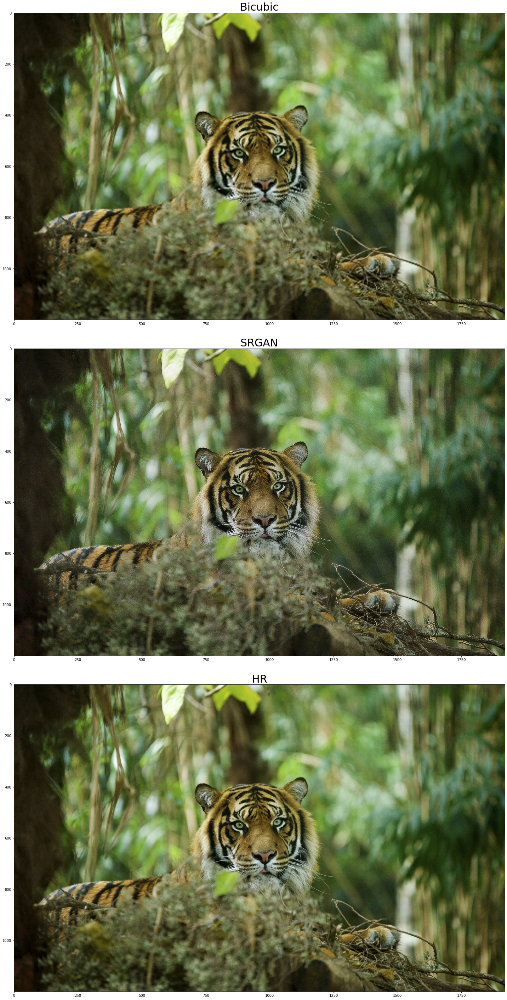

In [12]:
# bicubic interpolation
bicubic_img = cv2.resize(
    lr_image, 
    (hr_image.shape[1], hr_image.shape[0]), 
    interpolation=cv2.INTER_CUBIC
)

# SRGAN을 이용해 고해상도로 변환합니다.
srgan_img = apply_srgan(lr_image)

images = [bicubic_img, srgan_img, hr_image]
titles = ["Bicubic", "SRGAN", "HR"]

# bicubic, SRGAN 을 적용한 이미지와 원래의 고해상도 이미지를 시각화합니다.
plt.figure(figsize=(20,40))
for i, pind in enumerate([311, 312, 313]):
    plt.subplot(pind)
    plt.imshow(images[i])
    plt.title(titles[i], fontsize=30)
    plt.tight_layout()

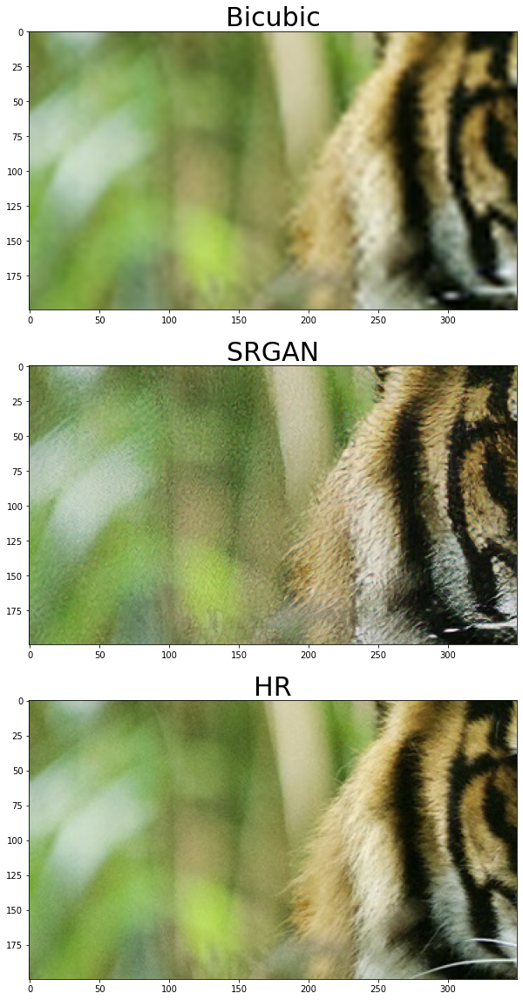

In [13]:
def crop(image, left_top, x=200, y=200):
    return image[left_top[0]:(left_top[0]+x), left_top[1]:(left_top[1]+y), :]

left_top = (500, 500) # 잘라낼 부분의 왼쪽 상단 좌표를 지정합니다.
plt.figure(figsize=(20,20))
for i, pind in enumerate([311, 312, 313]):
    plt.subplot(pind)
    plt.imshow(crop(images[i], left_top, 200, 350))
    plt.title(titles[i], fontsize=30)

/opt/conda/lib/python3.7/site-packages/skimage/metrics/simple_metrics.py:160: RuntimeWarning: divide by zero encountered in double_scalars
  return 10 * np.log10((data_range ** 2) / err)


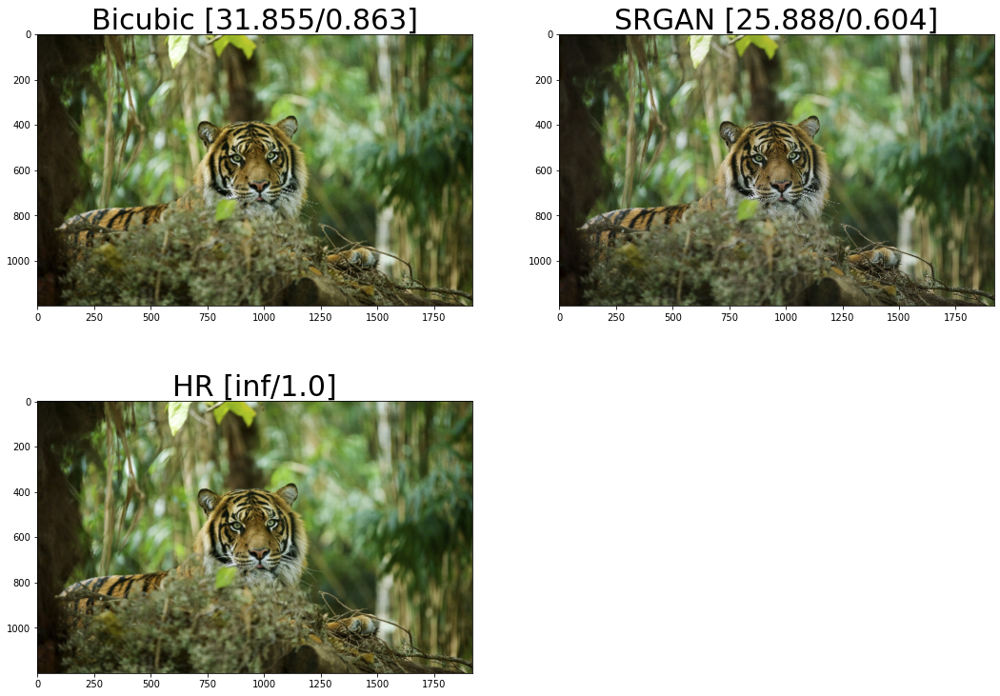

In [14]:
# 각 이미지에 대해 PSNR을 계산하고 반올림합니다.
psnr = [round(peak_signal_noise_ratio(hr_image, i), 3) for i in images]
# 각 이미지에 대해 SSIM을 계산하고 반올림합니다.
ssim = [round(structural_similarity(hr_image, i, multichannel=True), 3) for i in images]

# 이미지 제목에 PSNR과 SSIM을 포함하여 시각화 합니다. 
plt.figure(figsize=(18,13))
for i in range(3):
    plt.subplot(2,2,i+1)
    plt.imshow(images[i])
    plt.title(titles[i] + f" [{psnr[i]}/{ssim[i]}]", fontsize=30)

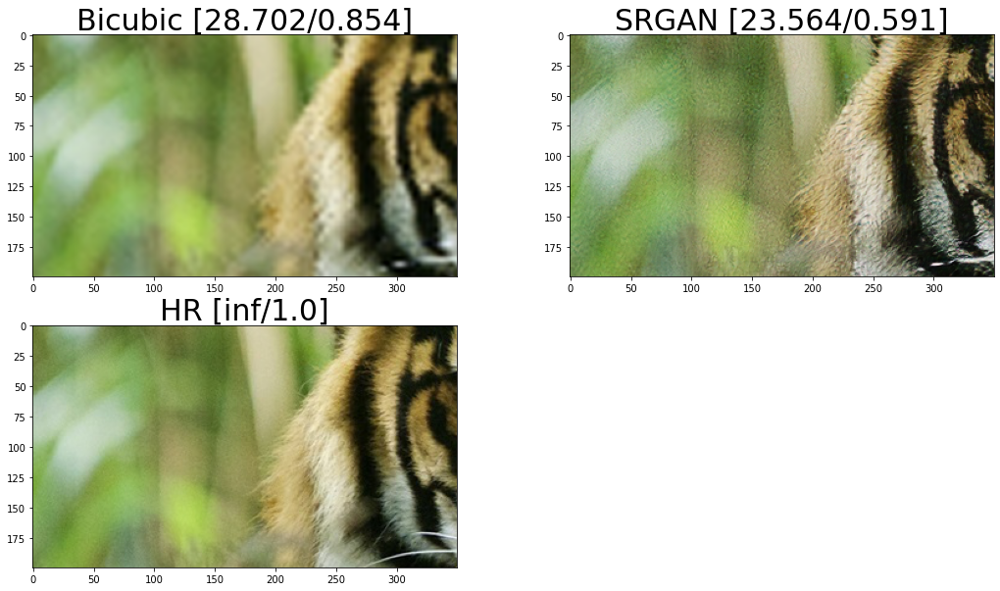

In [15]:
crop_images = [crop(i, left_top, 200, 350) for i in images]

psnr = [round(peak_signal_noise_ratio(crop_images[-1], i), 3) for i in crop_images]
ssim = [round(structural_similarity(crop_images[-1], i, multichannel=True), 3) for i in crop_images]

plt.figure(figsize=(18,10))
for i in range(3):
    plt.subplot(2,2,i+1)
    plt.imshow(crop_images[i])
    plt.title(titles[i] + f" [{psnr[i]}/{ssim[i]}]", fontsize=30)

SRGAN 결과의 경우 Generator가 고해상도 이미지를 생성하는 과정에서 Discriminator를 속이기 위해 이미지를 진짜 같이 선명하게 만들도록 학습 되었고,  저해상도 이미지가 매우 제한된 정보를 가지고 있기에 고해상도 이미지와 세부적으로 동일한 모양으로 선명하진 않다. 위의 이미지를 보면 배경의 노이즈도 더 선명해지고 털의 경우 SRGAN이 Bicubic보다 더 사실적으로 복원되긴 했지만 원본에 비해 거칠어 보인다. 그러다 보니 psnr과 ssim가 낮게 나온것 같다.

프로젝트 1-2

(450, 352, 3)


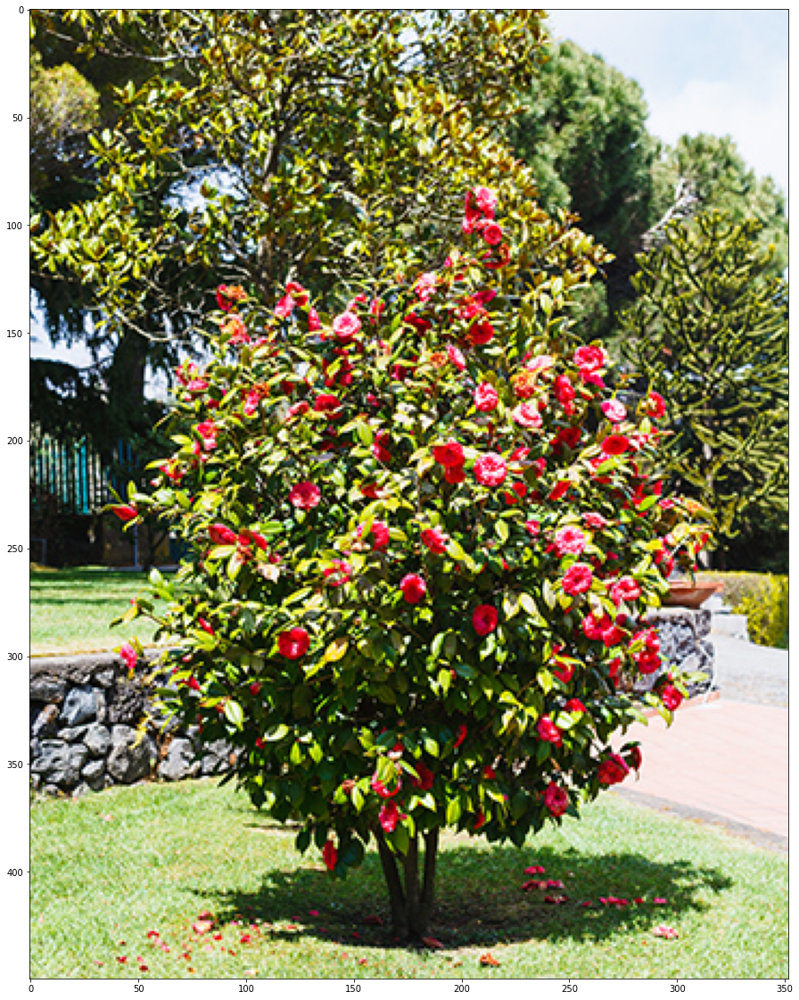

In [16]:
PATH = os.path.join(os.getenv('HOME')+'/aiffel/super_resolution/lrimg.jpg')

lr_image = plt.imread(PATH)
print(lr_image.shape)
plt.figure(figsize=(20,20))
plt.imshow(lr_image)

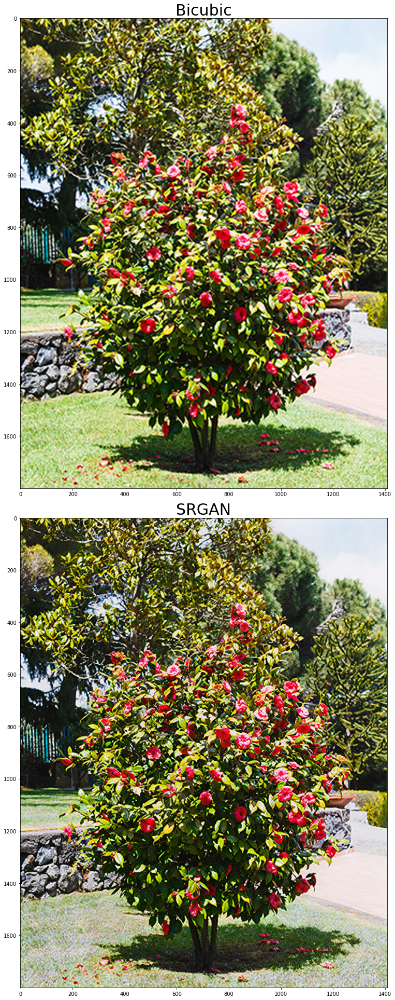

In [17]:
# bicubic interpolation
bicubic_img = cv2.resize(
    lr_image, 
    (lr_image.shape[1]*4, lr_image.shape[0]*4), 
    interpolation=cv2.INTER_CUBIC
)

# SRGAN을 이용해 고해상도로 변환합니다.
srgan_img = apply_srgan(lr_image)

images = [bicubic_img, srgan_img]
titles = ["Bicubic", "SRGAN"]

# bicubic, SRGAN 을 적용한 이미지와 원래의 고해상도 이미지를 시각화합니다.
plt.figure(figsize=(20,40))
for i, pind in enumerate([311, 312]):
    plt.subplot(pind)
    plt.imshow(images[i])
    plt.title(titles[i], fontsize=30)
    plt.tight_layout()

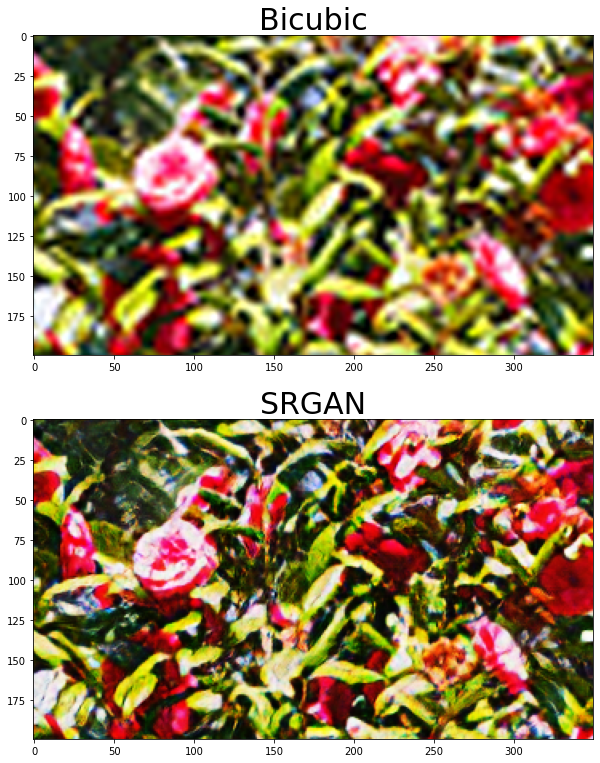

In [18]:
def crop(image, left_top, x=200, y=200):
    return image[left_top[0]:(left_top[0]+x), left_top[1]:(left_top[1]+y), :]

left_top = (500, 500) # 잘라낼 부분의 왼쪽 상단 좌표를 지정합니다.
plt.figure(figsize=(20,20))
for i, pind in enumerate([311, 312]):
    plt.subplot(pind)
    plt.imshow(crop(images[i], left_top, 200, 350))
    plt.title(titles[i], fontsize=30)

꽃과 나뭇잎, 돌과 같은 물체들은 SRGAN이 Bicubic보다 더 선명해서 사실적으로 보이도록 복원되긴 했지만, 선명하게 복원시키는 과정에서 바닥의 잔디색이 원본의 색과 달라졌다.

프로젝트 2

In [19]:
gif = cv2.VideoCapture(os.path.join(os.getenv('HOME')+'/aiffel/super_resolution/city_night_lr.gif'))

isTrue = True
frames = []
while isTrue:
    isTrue, frame = gif.read()
    if isTrue:
        frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        frames.append(frame)

print("frame 수 :", len(frames))
print("frame 크기 :", (frames[0].shape))

frame 수 : 8
frame 크기 : (255, 500, 3)


In [20]:
frames_sr_b = []
frames_sr_g = []
for i in range(len(frames)):    
    # bicubic interpolation
    bicubic_img = cv2.resize(
        frames[i], 
        (frames[i].shape[1]*4, frames[i].shape[0]*4), 
        interpolation=cv2.INTER_CUBIC
    )
    frames_sr_b.append(bicubic_img)
    # SRGAN을 이용해 고해상도로 변환합니다.
    srgan_img = apply_srgan(frames[i])
    frames_sr_g.append(srgan_img)

In [21]:
imageio.mimsave(os.path.join(os.getenv('HOME')+'/aiffel/super_resolution/city_night_hr_b.gif'), frames_sr_b)

In [22]:
imageio.mimsave(os.path.join(os.getenv('HOME')+'/aiffel/super_resolution/city_night_hr_g.gif'), frames_sr_g)

In [23]:
#show_gif(os.path.join(os.getenv('HOME')+'/aiffel/super_resolution/city_night_lr.gif'), width=1000)

city_night_lr
<img src= "https://lh5.googleusercontent.com/ztwbfjlxaPIVZFBgQ-go28NcOgxYrAYioivFqq6JsgPREEqUXhtKfNx4bz9HsGRUnZ0rDLOBTDdOUBfoC04H=w1227-h950" width='1000' height="500"></img>
https://drive.google.com/file/d/1IkskL237jxIxa6lUUGDY-whwPsCXIk80/view

city_night_hr_b
<img src= "https://lh3.googleusercontent.com/5N84XMbmjfP7RlBQP-o1sb3v7iafqKVKtyfUMPrqa8Y07fEpRsGc1x1_gN_Fv4c8UHgxLOWYXPI_qS91omVk=w1227-h950-rw" width='1000' height="500"></img>
https://drive.google.com/file/d/1VemE7C-dKh5QxJrM_XGArul12xofEpd0/view

city_night_hr_g
<img src= "https://lh5.googleusercontent.com/in4WvLx3vzqRYmIwRja3ifNkbkdrBCeCiqEzquscfyPcyAExGBGD-uYP1iZt9P4UViRr7zIy6s6Sw-f2hMcq=w1227-h950-rw" width='1000' height="500"></img>
https://drive.google.com/file/d/1aaPattnFcsCLmshHH7D6Yu9IeDQHnqOP/view

In [24]:
gif = cv2.VideoCapture(os.path.join(os.getenv('HOME')+'/aiffel/super_resolution/wine_lr.gif'))

isTrue = True
frames = []
while isTrue:
    isTrue, frame = gif.read()
    if isTrue:
        frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        frames.append(frame)

print("frame 수 :", len(frames))
print("frame 크기 :", (frames[0].shape))

frame 수 : 13
frame 크기 : (340, 355, 3)


In [25]:
frames_sr_b = []
frames_sr_g = []
for i in range(len(frames)):    
    # bicubic interpolation
    bicubic_img = cv2.resize(
        frames[i], 
        (frames[i].shape[1]*4, frames[i].shape[0]*4), 
        interpolation=cv2.INTER_CUBIC
    )
    frames_sr_b.append(bicubic_img)
    # SRGAN을 이용해 고해상도로 변환합니다.
    srgan_img = apply_srgan(frames[i])
    frames_sr_g.append(srgan_img)

In [26]:
imageio.mimsave(os.path.join(os.getenv('HOME')+'/aiffel/super_resolution/wine_hr_b.gif'), frames_sr_b)

In [27]:
imageio.mimsave(os.path.join(os.getenv('HOME')+'/aiffel/super_resolution/wine_hr_g.gif'), frames_sr_g)

wine_lr
<img src= "https://lh5.googleusercontent.com/fTDRej9xRS9nT6cE5TKx--sSdX_YdjQ1GhZTnqcWgU_2-xRnIQHA5TQ40WLECYG0zAY6x11PIci5e6pgwgfc=w1920-h950" width="1000" height="1000"></img>
https://drive.google.com/file/d/1Vl19L-SL1J2oQ9tj1kQefI9K-VvLXb4d/view

wine_hr_b
<img src= "https://lh6.googleusercontent.com/zFb3bWlYRPAm5jaV8_rr6VpBOj3p_UM8Pt-lRvf4XmvalQ2bJ7lp7IGT_KfJVBIMP5BV77lSsK_u387OGRbh=w1227-h950-rw" width='1000' height="1000"></img>
https://drive.google.com/file/d/1E9fKBGQ-MCX1etv-5YBXKnpSL_iJjqcB/view

wine_hr_g
<img src= "https://lh6.googleusercontent.com/tq3r_474xcZXe-GaA0c2pm_MNbp92mK-ibykVrUxXSErjJpjwOt4xu7zCGHk1rJFNRgUGAFke_CscK8tW54A=w1227-h950-rw" width='1000' height="1000"></img>
https://drive.google.com/file/d/1fr0bDGLEq72TUpS2rIcLD8EwNmefZzBU/view